In [1]:
import math
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from ipywidgets import IntProgress
import os
import cv2
import PIL
import PIL.Image
import json
import random
from random import randint as rand
from os import listdir
from os.path import isfile, join
gpus = tf.config.experimental.list_physical_devices('GPU')
print(gpus)
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

[]


In [2]:
import random
import tensorflow as tf
import matplotlib.image as mpimg
import numpy as np


def generator():
    path = r'C:\Users\Ильяс\.cache\roboflow\PPE.v14i.yolokeras\update__annotations.txt'
    data = open(path, 'r').readlines()
    for el in data:
        path_image = el.replace('\n', '')
        path_label = (
            'C:\\Users\\Ильяс\\.cache\\roboflow\\PPE.v14i.yolokeras\\train\\labels\\'
            + path_image.split('\\')[-1].replace('\n', '') + '.txt'
        )

        bbox = []
        try:
            with open(path_label, 'r') as f:
                label = f.readlines()

            for e in label:
                if len(e) <= 1:
                    continue
                li = e.split()[1:]
                if len(li) < 4:
                    continue

                # Лейблы уже в формате x1, y1, x2, y2 (нормализованные 0..1) -> домножаем на 224
                x1 = float(li[0]) 
                y1 = float(li[1])
                x2 = float(li[2]) 
                y2 = float(li[3])
                w = x2-x1
                h=y2-y1

                x=(x1+x2)/2
                y=(y1+y2)/2
                x1=x
                y1=y
                x2=w
                y2=h
                

                bbox.append([x1, y1, x2, y2])
                if len(bbox) >= 50:
                    break
        except FileNotFoundError:
            continue

        try:
            image = tf.image.resize(
                tf.cast(mpimg.imread(path_image), tf.float32),
                (224, 224)
            ) / 255.0
        except Exception as e:
            continue

        if len(bbox) == 0:
            continue

        # Пока ротация только 0, поэтому боксы не меняем
        rotation = random.choice([0])
        rotated_image = tf.image.rot90(image, k=rotation)

        rotated_bbox = []
        for box in bbox:
            x1, y1, x2, y2 = box

            if rotation == 1:
                # ПРИМЕР (если будете включать ротацию 90°):
                # new_x1 = y1
                # new_y1 = 224 - x2
                # new_x2 = y2
                # new_y2 = 224 - x1
                # здесь можно дописать реальную логику, пока rotation=0 это не используется
                new_x1, new_y1, new_x2, new_y2 = x1, y1, x2, y2
            elif rotation == 2:
                # Аналогично, можно реализовать поворот на 180°
                new_x1, new_y1, new_x2, new_y2 = x1, y1, x2, y2
            elif rotation == 3:
                # Аналогично, поворот на 270°
                new_x1, new_y1, new_x2, new_y2 = x1, y1, x2, y2
            else:
                new_x1, new_y1, new_x2, new_y2 = x1, y1, x2, y2

            # Добавляем флаг 0 для GT боксов
            rotated_bbox.append([new_x1, new_y1, new_x2, new_y2, 0.0])

        

        all_boxes = rotated_bbox 

        yield (rotated_image, tf.constant(all_boxes, dtype=tf.float32))
def valid_generator():
    path = r'C:\Users\Ильяс\.cache\roboflow\PPE.v14i.yolokeras\update_test_annotations.txt'
    data = open(path, 'r').readlines()
    for el in data:
        path_image = el.replace('\n', '')
        path_label = (
            'C:\\Users\\Ильяс\\.cache\\roboflow\\PPE.v14i.yolokeras\\test\\labels\\'
            + path_image.split('\\')[-1].replace('\n', '') + '.txt'
        )

        bbox = []
        try:
            with open(path_label, 'r') as f:
                label = f.readlines()

            for e in label:
                if len(e) <= 1:
                    continue
                li = e.split()[1:]
                if len(li) < 4:
                    continue

                # Формат x1, y1, x2, y2 (нормализованные) -> домножаем на 224
                x1 = float(li[0]) 
                y1 = float(li[1]) 
                x2 = float(li[2]) 
                y2 = float(li[3]) 
                w=x2-x1
                h=y2-y1

                x=(x1+x2)/2
                y=(y1+y2)/2
                x1=x
                y1=y
                x2=w
                y2=h

                bbox.append([x1, y1, x2, y2])
                if len(bbox) >= 50:
                    break
        except FileNotFoundError:
            continue

        try:
            image = tf.image.resize(
                tf.cast(mpimg.imread(path_image), tf.float32),
                (224, 224)
            ) / 255.0
        except Exception as e:
            continue

        if len(bbox) == 0:
            continue

        # Добавляем флаг 0 для GT боксов в валидационном наборе
        bbox_with_flag = [[x1, y1, x2, y2, 0.0] for x1, y1, x2, y2 in bbox]

        yield (image, tf.constant(bbox_with_flag, dtype=tf.float32))
# Создаем datasets для одиночных примеров
dataset = tf.data.Dataset.from_generator(
    generator,
    output_signature=(
        tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
        tf.TensorSpec(shape=(None, 5), dtype=tf.float32)  # [x1, y1, x2, y2, flag]
    )
)

valid_dataset = tf.data.Dataset.from_generator(
    valid_generator,
    output_signature=(
        tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
        tf.TensorSpec(shape=(None, 5), dtype=tf.float32)  # [x1, y1, x2, y2, flag]
    )
)

# Кэшируем и перемешиваем (БЕЗ .batch()!)
dataset = dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE).shuffle(100)
valid_dataset = valid_dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE)


In [3]:
backbone_encoder = tf.keras.models.load_model(
    r'models/base_classifier.h5', 
    compile=False,
)

In [4]:
output_tensor = backbone_encoder.output
clipped_model = tf.keras.Model(backbone_encoder.input, output_tensor)

In [5]:
clipped_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃         Param # ┃ Connected to               ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, 224, 224, 3)       │               0 │ -                          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ Conv1 (Conv2D)                │ (None, 112, 112, 32)      │             864 │ input_layer[0][0]          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ bn_Conv1 (BatchNormalization) │ (None, 112, 112, 32)      │             128 │ Conv1[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ Conv1_relu (ReLU)             │ (None, 112, 112, 32)      │               0 │ bn_Conv1[0][0]             │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ expanded_conv_depthwise       │ (None, 112, 112, 32)      │             288 │ Conv1_relu[0][0]           │
│ (DepthwiseConv2D)             │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ expanded_conv_depthwise_BN    │ (None, 112, 112, 32)      │             128 │ expanded_conv_depthwise[0… │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ expanded_conv_depthwise_relu  │ (None, 112, 112, 32)      │               0 │ expanded_conv_depthwise_B… │
│ (ReLU)                        │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ expanded_conv_project         │ (None, 112, 112, 16)      │             512 │ expanded_conv_depthwise_r… │
│ (Conv2D)                      │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ expanded_conv_project_BN      │ (None, 112, 112, 16)      │              64 │ expanded_conv_project[0][… │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ block_1_expand (Conv2D)       │ (None, 112, 112, 96)      │           1,536 │ expanded_conv_project_BN[… │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ block_1_expand_BN             │ (None, 112, 112, 96)      │             384 │ block_1_expand[0][0]       │
│ (BatchNormalization)          │                           │                 │                            │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ block_1_expand_relu (ReLU)    │ (None, 112, 112, 96)      │               0 │ block_1_expand_BN[0][0]    │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ block_1_pad (ZeroPadding2D)   │ (None, 113, 113, 96)      │               0 │ block_1_expand_relu[0][0]  │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ block_1_depthwise             │ (None, 56, 56, 96)        │             864 │ block_1_pad[0][0]          │
│ (DepthwiseConv2D)             │                           │               

 Total params: 616,256 (2.35 MB)

 Trainable params: 334,272 (1.28 MB)

 Non-trainable params: 281,984 (1.08 MB)

In [6]:
X = []
y = []

for el in dataset:
    X.append(clipped_model.predict(tf.expand_dims(el[0], axis = 0), verbose = 0))
    y.append(el[1][:, :-1])

X = np.array(X)


In [7]:
y = np.array(y, dtype=object) 

In [8]:
y = y.reshape(y.shape[0], -1)

In [9]:
y = [el[0].numpy().flatten() for el in y]

In [10]:
X.shape

(3725, 1, 7, 7, 1152)

In [11]:
max_len = max(len(el) for el in y)

In [12]:
y_padded = []
for arr in y:
    pad_size = max_len - len(arr)
    padded = np.pad(arr, (0, pad_size), mode='constant', constant_values=0)
    y_padded.append(padded)

y = np.array(y_padded)


In [13]:
y.shape

(3725, 200)

In [14]:
X_val = []
y_val = []
for el in valid_dataset:
    X_val.append(clipped_model.predict(tf.expand_dims(el[0], axis = 0), verbose = 0))
    y_val.append(el[1][:, :-1])

X_val = np.array(X_val)


In [15]:
y_val = np.array(y_val, dtype = np.object_)

In [16]:
y_val = y_val.reshape(y_val.shape[0], -1)

In [17]:
y_val = [el[0].numpy().flatten() for el in y_val]

In [18]:
y_val[0]

array([0.49140626, 0.16484375, 0.1171875 , 0.1046875 , 0.5023438 ,
       0.43828124, 0.1921875 , 0.2984375 , 0.49765626, 0.5359375 ,
       0.2765625 , 0.928125  ], dtype=float32)

In [19]:
y_padded = []
for arr in y_val:
    pad_size = max_len - len(arr)
    padded = np.pad(arr, (0, pad_size), mode='constant', constant_values=0)
    y_padded.append(padded)

y_val = np.array(y_padded)

In [20]:
X_val.shape

(92, 1, 7, 7, 1152)

In [21]:
y_val.shape

(92, 200)

In [42]:
import json
with open('models/Ridge_head.json', 'r') as f:
    W = json.load(f)

W = np.array(W['W'])

In [44]:
W.shape

(1152, 200)

In [45]:
X = np.squeeze(X, axis=1)       
X_val = np.squeeze(X_val, axis=1)

ValueError: cannot select an axis to squeeze out which has size not equal to one

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt

def get_iou_and_mask(y_true, y_pred):
    """Вспомогательная функция для расчета IoU и масок объектов"""
    true_boxes = tf.reshape(y_true, (-1, 50, 4))
    pred_boxes = tf.reshape(y_pred, (-1, 50, 4))

    # Маска реальных объектов (где GT не нули)
    mask = tf.cast(tf.reduce_sum(tf.abs(true_boxes), axis=-1) > 0.0001, tf.float32)

    gt_cx, gt_cy, gt_w, gt_h = tf.unstack(true_boxes, axis=-1)
    p_cx, p_cy, p_w, p_h = tf.unstack(pred_boxes, axis=-1)

    gt_x1 = gt_cx - gt_w / 2.0
    gt_y1 = gt_cy - gt_h / 2.0
    gt_x2 = gt_cx + gt_w / 2.0
    gt_y2 = gt_cy + gt_h / 2.0

    p_x1 = p_cx - p_w / 2.0
    p_y1 = p_cy - p_h / 2.0
    p_x2 = p_cx + p_w / 2.0
    p_y2 = p_cy + p_h / 2.0

    inter_x1 = tf.maximum(gt_x1, p_x1)
    inter_y1 = tf.maximum(gt_y1, p_y1)
    inter_x2 = tf.minimum(gt_x2, p_x2)
    inter_y2 = tf.minimum(gt_y2, p_y2)

    inter_w = tf.maximum(0.0, inter_x2 - inter_x1)
    inter_h = tf.maximum(0.0, inter_y2 - inter_y1)
    inter_area = inter_w * inter_h

    gt_area = gt_w * gt_h
    p_area = p_w * p_h
    union_area = gt_area + p_area - inter_area + 1e-7

    iou = inter_area / union_area
    return iou, mask, p_area

def metric_recall(y_true, y_pred):
    """Recall@0.5: Какую долю реальных объектов мы нашли с IoU > 0.5"""
    iou, mask, _ = get_iou_and_mask(y_true, y_pred)
    
    # Считаем совпадением, если IoU > 0.5
    true_positives = tf.cast(iou > 0.5, tf.float32) * mask
    
    # Recall = TP / (Total Real Objects)
    return tf.reduce_sum(true_positives) / (tf.reduce_sum(mask) + 1e-7)

def metric_precision(y_true, y_pred):
    """
    Precision@0.5: Доля корректных предсказаний среди всех 'активных' предсказаний.
    Т.к. нет score, считаем предсказание 'активным', если его площадь > 0.005
    """
    iou, mask, p_area = get_iou_and_mask(y_true, y_pred)
    
    # TP: IoU > 0.5 на реальном объекте
    true_positives = tf.cast(iou > 0.5, tf.float32) * mask
    
    # Предсказанные боксы (считаем бокс предсказанным, если его площадь не околонулевая)
    # Порог 0.005 можно настроить (0.5% от площади картинки)
    predicted_boxes_mask = tf.cast(p_area > 0.005, tf.float32)
    
    # Precision = TP / (All Predicted Boxes)
    return tf.reduce_sum(true_positives) / (tf.reduce_sum(predicted_boxes_mask) + 1e-7)

def metric_mean_iou(y_true, y_pred):
    """Средний IoU только на реальных объектах"""
    iou, mask, _ = get_iou_and_mask(y_true, y_pred)
    
    masked_iou = iou * mask
    return tf.reduce_sum(masked_iou) / (tf.reduce_sum(mask) + 1e-7)


def masked_ciou_loss(y_true, y_pred):

    true_boxes = tf.reshape(y_true, (-1, 50, 4))
    pred_boxes = tf.reshape(y_pred, (-1, 50, 4))


    mask = tf.cast(tf.reduce_sum(tf.abs(true_boxes), axis=-1) > 0.0001, tf.float32)
    mask = tf.expand_dims(mask, axis=-1)

    gt_cx, gt_cy, gt_w, gt_h = tf.unstack(true_boxes, axis=-1)
    p_cx, p_cy, p_w, p_h = tf.unstack(pred_boxes, axis=-1)

    gt_x1 = gt_cx - gt_w / 2.0
    gt_y1 = gt_cy - gt_h / 2.0
    gt_x2 = gt_cx + gt_w / 2.0
    gt_y2 = gt_cy + gt_h / 2.0

    p_x1 = p_cx - p_w / 2.0
    p_y1 = p_cy - p_h / 2.0
    p_x2 = p_cx + p_w / 2.0
    p_y2 = p_cy + p_h / 2.0

    inter_x1 = tf.maximum(gt_x1, p_x1)
    inter_y1 = tf.maximum(gt_y1, p_y1)
    inter_x2 = tf.minimum(gt_x2, p_x2)
    inter_y2 = tf.minimum(gt_y2, p_y2)

    inter_w = tf.maximum(0.0, inter_x2 - inter_x1)
    inter_h = tf.maximum(0.0, inter_y2 - inter_y1)
    inter_area = inter_w * inter_h

    gt_area = gt_w * gt_h
    p_area = p_w * p_h
    union_area = gt_area + p_area - inter_area + 1e-7

    iou = inter_area / union_area

    c_x1 = tf.minimum(gt_x1, p_x1)
    c_y1 = tf.minimum(gt_y1, p_y1)
    c_x2 = tf.maximum(gt_x2, p_x2)
    c_y2 = tf.maximum(gt_y2, p_y2)
    
    c_diag = tf.square(c_x2 - c_x1) + tf.square(c_y2 - c_y1) + 1e-7
    rho2 = tf.square(gt_cx - p_cx) + tf.square(gt_cy - p_cy)
    diou = rho2 / c_diag


    w_h_ratio_gt = tf.atan(gt_w / (gt_h + 1e-7))
    w_h_ratio_pred = tf.atan(p_w / (p_h + 1e-7))
    
    v = (4.0 / (math.pi ** 2)) * tf.square(w_h_ratio_gt - w_h_ratio_pred)
    
    alpha = v / (1.0 - iou + v + 1e-7)
    
    ciou_val = iou - diou - (alpha * v)
    
    ciou_loss_val = 1.0 - ciou_val
    

    obj_loss = ciou_loss_val * tf.squeeze(mask, axis=-1)


    no_obj_mask = 1.0 - mask
    
    silence_loss = tf.reduce_sum(tf.square(pred_boxes), axis=-1) 
    silence_loss = silence_loss * tf.squeeze(no_obj_mask, axis=-1)

    silence_weight = 0.3 
    
    total_loss = tf.reduce_sum(obj_loss) + silence_weight * tf.reduce_sum(silence_loss)
    
    num_objects = tf.reduce_sum(mask) + 1.0
    
    return total_loss / num_objects



def create_ciou_mlp():
    feat_in  = tf.keras.Input(shape=(7,7,1152), name="feat")

    ridge_in = tf.keras.layers.GlobalAveragePooling2D()(feat_in)
    ridge_dense = tf.keras.layers.Dense(200, use_bias=None, activation=None)
    ridge_dense.trainable = False  
    ridge_in =  ridge_dense(ridge_in)
    ridge_emb = tf.keras.layers.Dense(32, activation='relu')(ridge_in)

    x = tf.keras.layers.Conv2D(128, 1, activation="relu")(feat_in)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    
    

    x = tf.keras.layers.Concatenate(axis=-1)([x, ridge_emb])

    x = tf.keras.layers.Dense(200, activation = 'sigmoid')(x)

    ridge_dense.set_weights([W])
    
    model = tf.keras.Model(feat_in, x)
    model.compile(optimizer=tf.keras.optimizers.Adam(1e-3), loss=masked_ciou_loss,
                 metrics=[metric_recall, metric_precision, metric_mean_iou])

    
    return model




y_train_padded = y 
model = create_ciou_mlp()
history = model.fit(
    X, y,
    validation_data=(X_val, y_val),
    batch_size=32,
    epochs=1200,
    
)



Epoch 1/1200
117/117 ━━━━━━━━━━━━━━━━━━━━ 4s 17ms/step - loss: 1.2415 - metric_mean_iou: 0.1630 - metric_precision: 0.0769 - metric_recall: 0.1022 - val_loss: 0.8557 - val_metric_mean_iou: 0.2610 - val_metric_precision: 0.1704 - val_metric_recall: 0.2512
Epoch 2/1200
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 1.0028 - metric_mean_iou: 0.1994 - metric_precision: 0.0999 - metric_recall: 0.1542 - val_loss: 0.7953 - val_metric_mean_iou: 0.3237 - val_metric_precision: 0.2407 - val_metric_recall: 0.3537
Epoch 3/1200
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.9478 - metric_mean_iou: 0.2177 - metric_precision: 0.1155 - metric_recall: 0.1798 - val_loss: 0.8663 - val_metric_mean_iou: 0.2487 - val_metric_precision: 0.1259 - val_metric_recall: 0.1799
Epoch 4/1200
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.9129 - metric_mean_iou: 0.2309 - metric_precision: 0.1331 - metric_recall: 0.1940 - val_loss: 0.7893 - val_metric_mean_iou: 0.3043 - val_metric_precision: 0.1978 - val_me

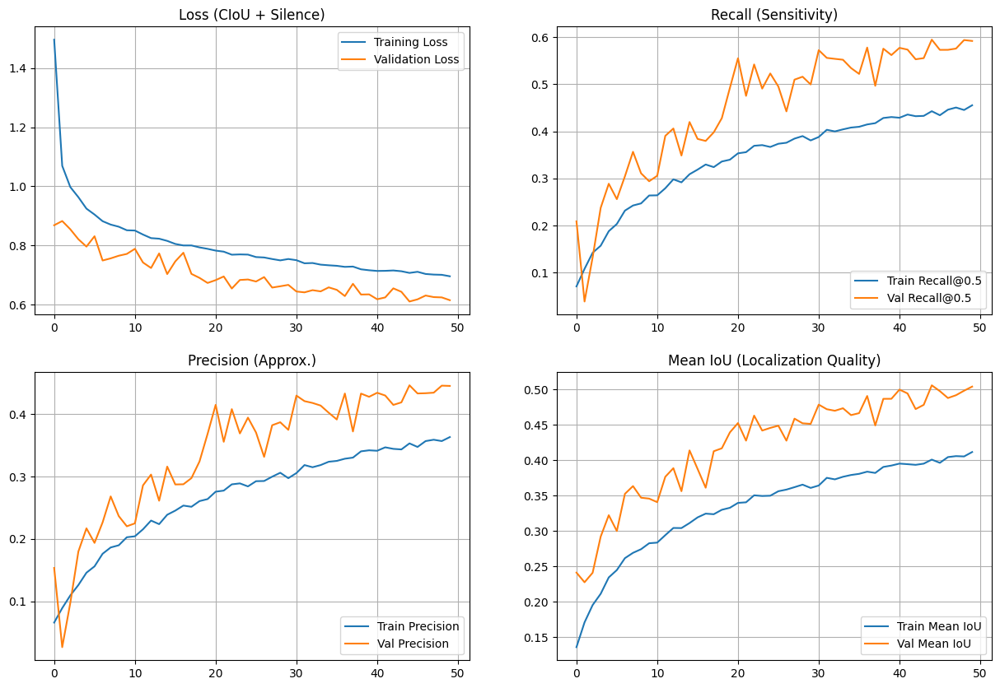

In [74]:
def plot_training_history(history):
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    
    recall = history.history['metric_recall']
    val_recall = history.history['val_metric_recall']
    
    precision = history.history['metric_precision']
    val_precision = history.history['val_metric_precision']
    
    miou = history.history['metric_mean_iou']
    val_miou = history.history['val_metric_mean_iou']

    epochs_range = range(len(loss))

    plt.figure(figsize=(15, 10))

    # График Loss
    plt.subplot(2, 2, 1)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Loss (CIoU + Silence)')
    plt.grid(True)

    # График Recall
    plt.subplot(2, 2, 2)
    plt.plot(epochs_range, recall, label='Train Recall@0.5')
    plt.plot(epochs_range, val_recall, label='Val Recall@0.5')
    plt.legend(loc='lower right')
    plt.title('Recall (Sensitivity)')
    plt.grid(True)

    # График Precision
    plt.subplot(2, 2, 3)
    plt.plot(epochs_range, precision, label='Train Precision')
    plt.plot(epochs_range, val_precision, label='Val Precision')
    plt.legend(loc='lower right')
    plt.title('Precision (Approx.)')
    plt.grid(True)
    
    # График Mean IoU
    plt.subplot(2, 2, 4)
    plt.plot(epochs_range, miou, label='Train Mean IoU')
    plt.plot(epochs_range, val_miou, label='Val Mean IoU')
    plt.legend(loc='lower right')
    plt.title('Mean IoU (Localization Quality)')
    plt.grid(True)

    plt.show()

# Вызов после обучения
plot_training_history(history)


In [67]:
history.history.keys()

dict_keys(['loss', 'val_loss'])

In [76]:
y_pred = model.predict(X_val)

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


In [77]:
from sklearn.metrics import mean_squared_error

In [78]:
mean_squared_error(y_val * 224, y_pred * 224)

np.float32(107.4173)

In [79]:
def restore_bboxes_auto(padded_array, threshold=0):
    
    non_zero_indices = np.where(np.abs(padded_array) > threshold)[0]
    
    if len(non_zero_indices) == 0:
        return np.array([]).reshape(0, 4)
    
    last_non_zero = non_zero_indices[-1]
    
    num_elements = last_non_zero + 1
    
    if num_elements % 4 != 0:
        num_elements = (num_elements // 4) * 4
        print(f"Внимание: количество элементов {last_non_zero+1} не кратно 4. Используем {num_elements}")
    
    real_data = padded_array[:num_elements]
    
    num_bboxes = num_elements // 4
    
    return real_data.reshape(num_bboxes, 4)

restored_auto = restore_bboxes_auto(y_pred[0])
print(f"Автоматически восстановлено bbox: {restored_auto.shape}")

Автоматически восстановлено bbox: (50, 4)


In [80]:
y_pred = [restore_bboxes_auto(el) for el in y_pred]

In [81]:
images = [el[0] for el in valid_dataset]

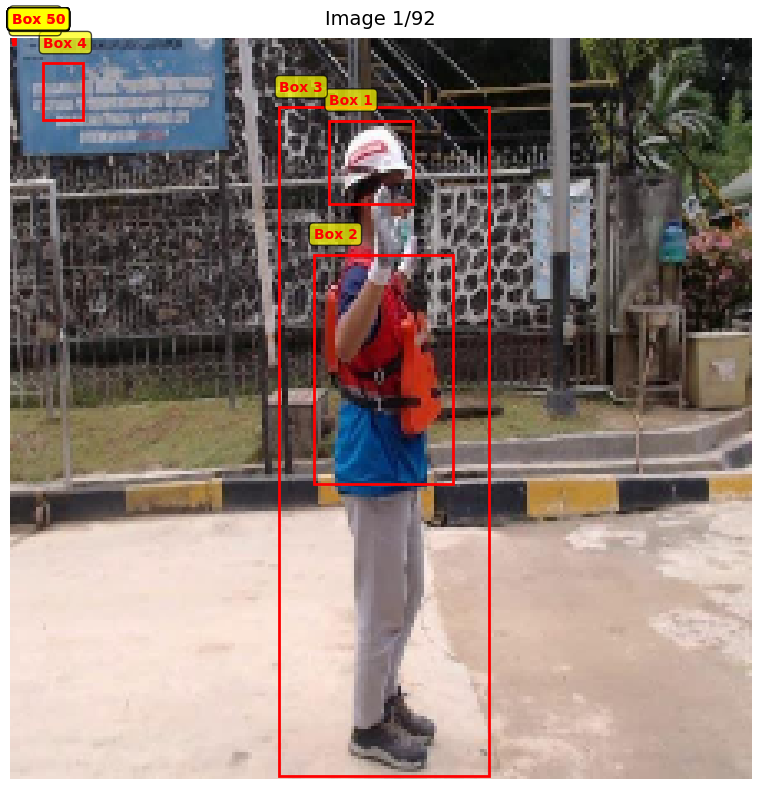

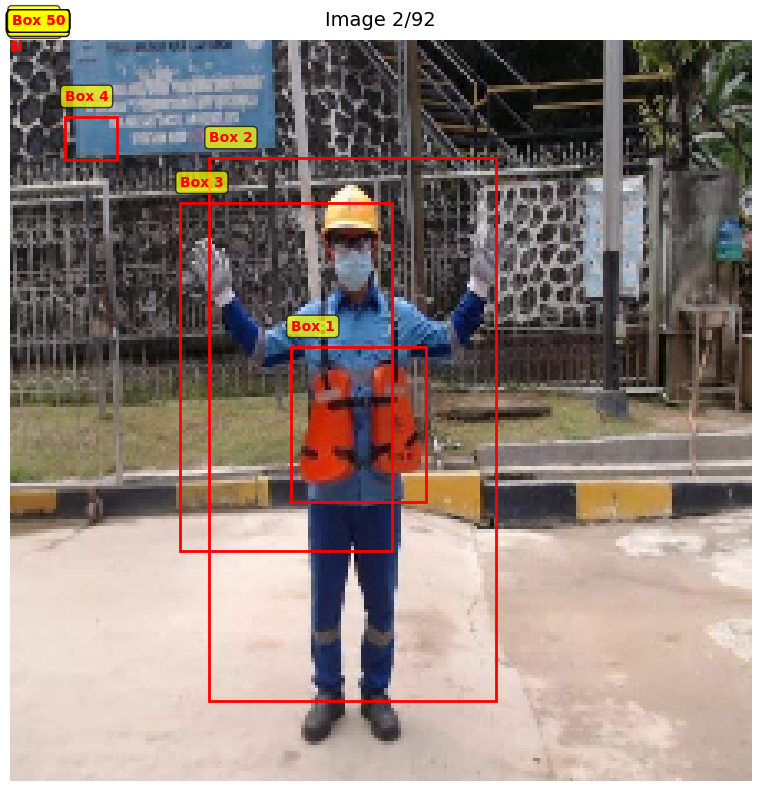

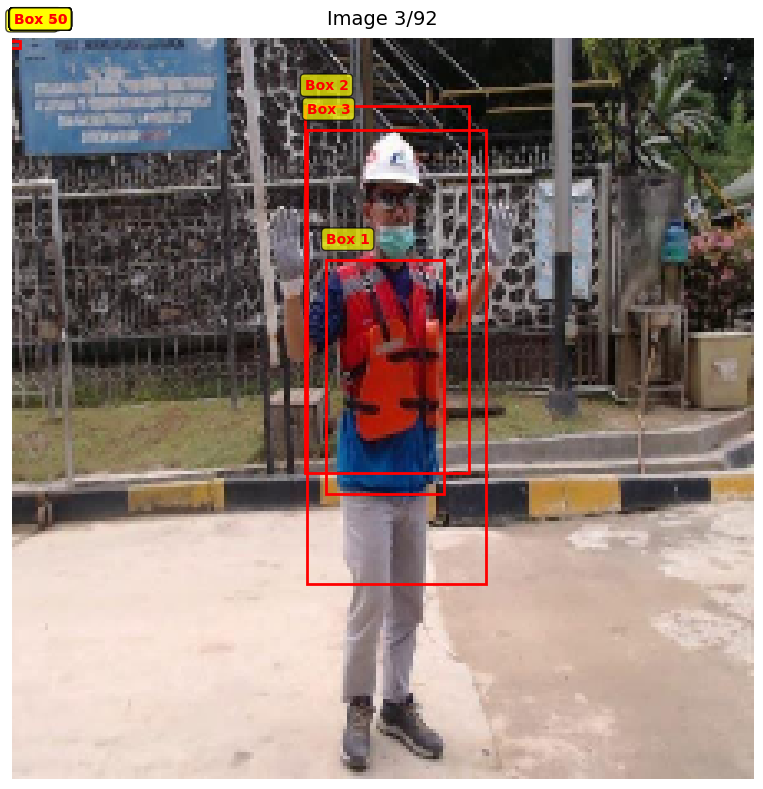

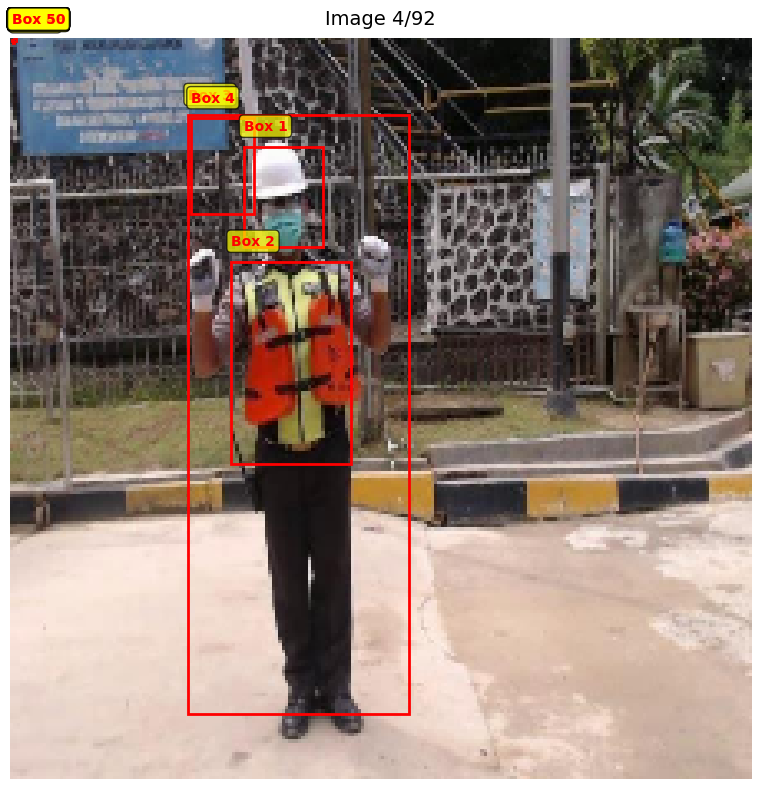

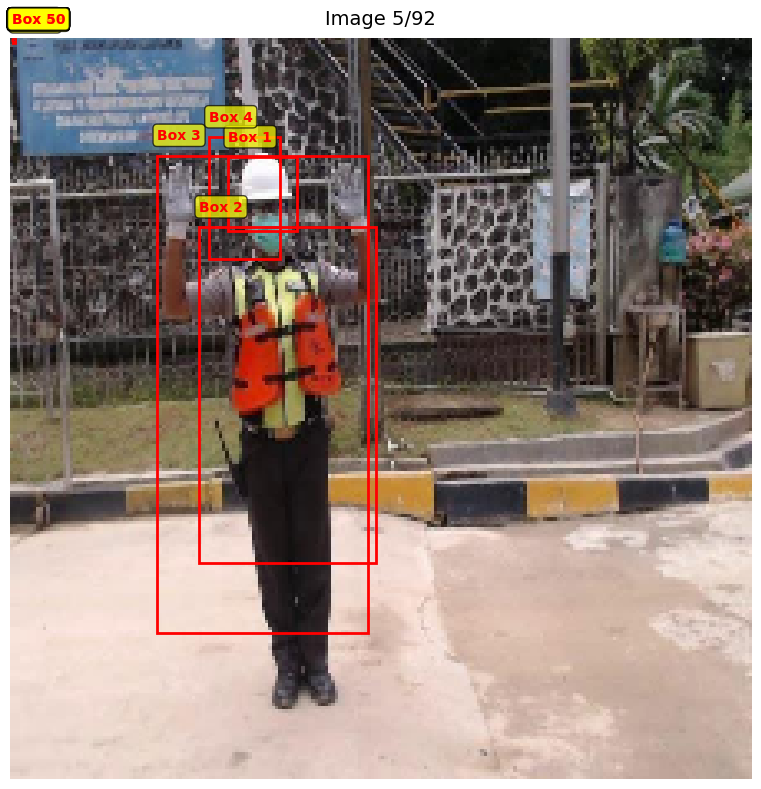

...

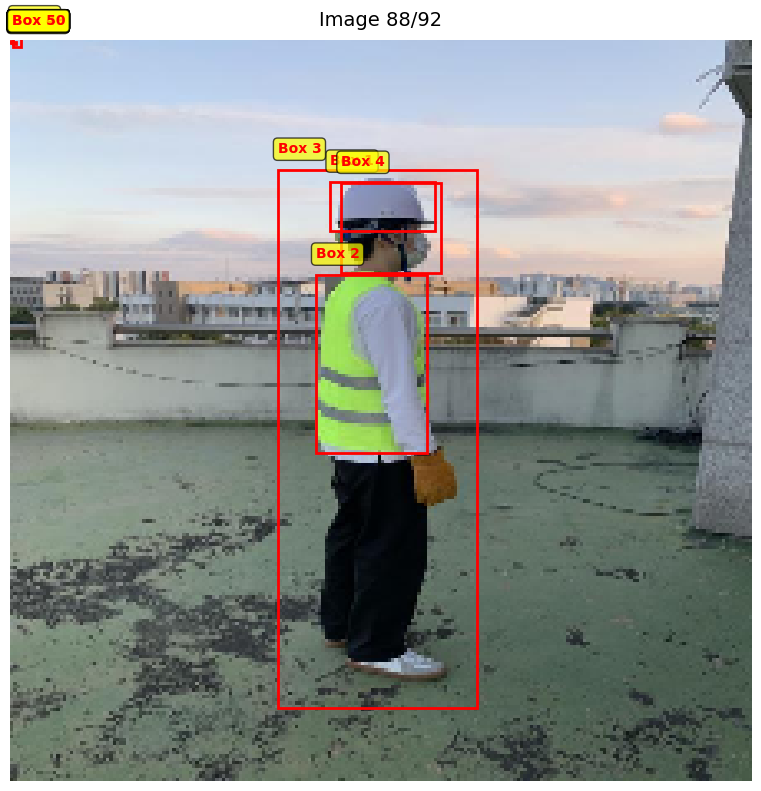

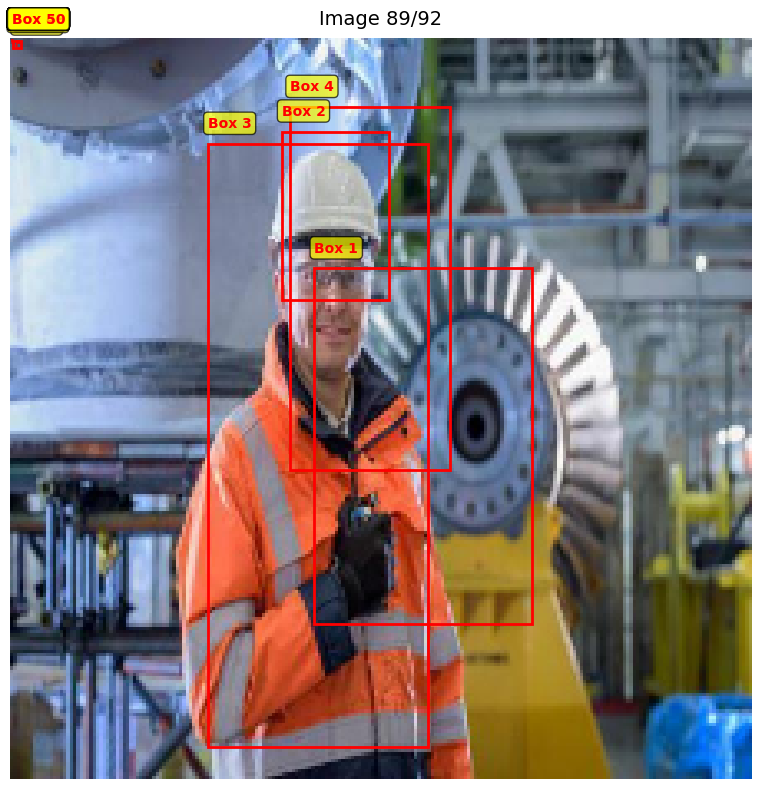

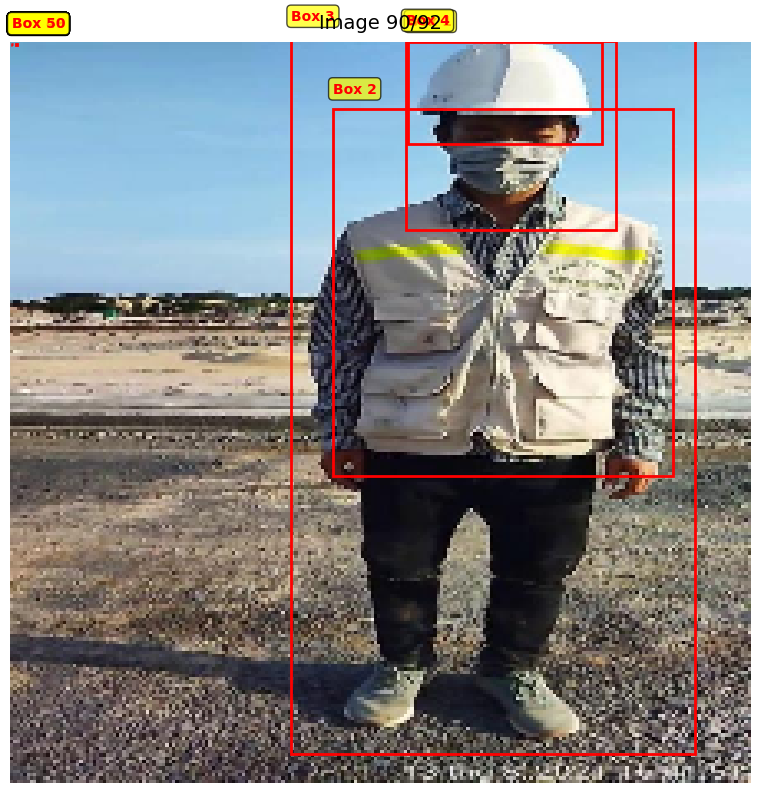

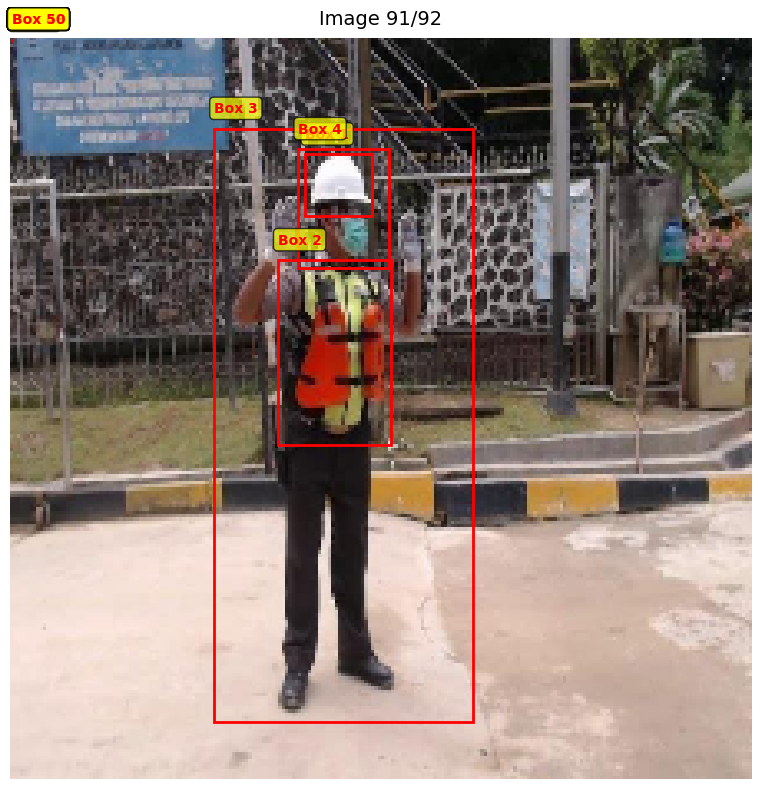

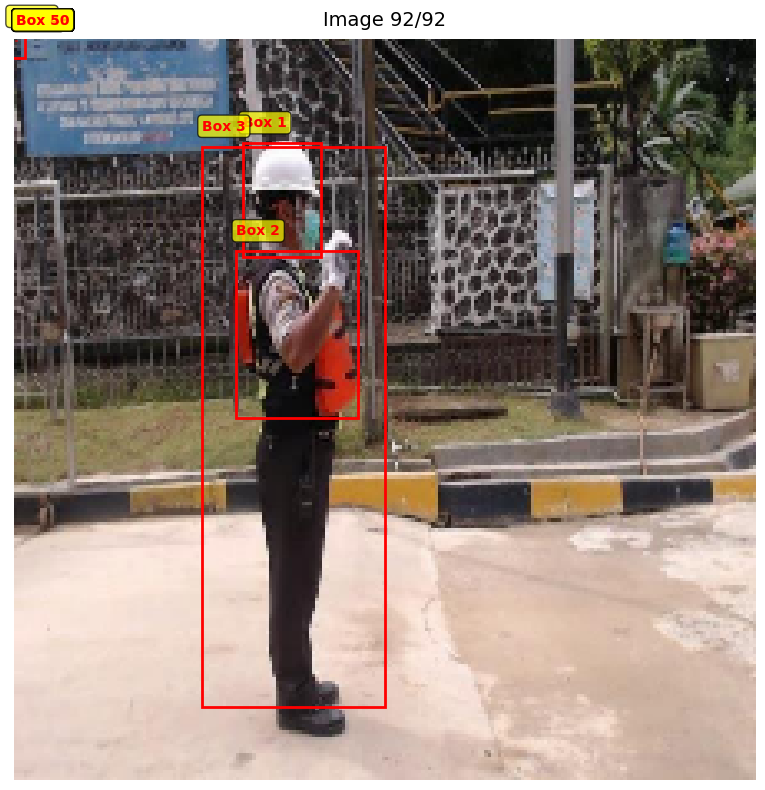


Отображено 92 изображений


In [82]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

def visualize_predictions(images, bboxes, num_samples=5, figsize=(12, 8), conf_threshold=0.5):
    
    
    num_to_show = min(num_samples, len(images), len(bboxes))
    
    for i in range(num_to_show):
        fig, ax = plt.subplots(1, figsize=figsize)
        
        ax.imshow(images[i])
        ax.axis('off')
        ax.set_title(f'Image {i+1}/{num_to_show}', fontsize=14, pad=10)
        
        img_bboxes = bboxes[i]
        
        if not isinstance(img_bboxes, (list, np.ndarray)):
            img_bboxes = [img_bboxes]
        
        if len(img_bboxes) == 0:
            ax.text(112, 112, 'No objects detected', 
                   ha='center', va='center', 
                   fontsize=12, color='red',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        else:
            for idx, bbox in enumerate(img_bboxes):
                if len(bbox) >= 4:
                    x, y, w, h = bbox[0] * 224, bbox[1] * 224, bbox[2] * 224, bbox[3] * 224
                    x-=w/2
                    y-=h/2
                    
                 
                    rect = patches.Rectangle(
                        (x, y), w, h,
                        linewidth=2,
                        edgecolor='red',
                        facecolor='none',
                        linestyle='-'
                    )
                    ax.add_patch(rect)
                    
                    ax.text(
                        x, y - 5,
                        f'Box {idx+1}',
                        color='red',
                        fontsize=10,
                        weight='bold',
                        bbox=dict(boxstyle='round,pad=0.3', facecolor='yellow', alpha=0.7)
                    )
                    
                    if len(bbox) >= 5:
                        conf = float(bbox[4])
                        if conf >= conf_threshold:
                            ax.text(
                                x, y + h + 15,
                                f'Conf: {conf:.2f}',
                                color='green',
                                fontsize=9,
                                bbox=dict(boxstyle='round,pad=0.2', facecolor='white', alpha=0.7)
                            )
        
        plt.tight_layout()
        plt.show()
    
    print(f'\nОтображено {num_to_show} изображений')



visualize_predictions(images, y_pred, num_samples=100)


In [60]:
model.save('models/RPN_MODEL_with_ RIDGE.h5')

In [61]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_model = converter.convert()

INFO:tensorflow:Assets written to: C:\Users\47A8~1\AppData\Local\Temp\tmpliv8_j5z\assets


INFO:tensorflow:Assets written to: C:\Users\47A8~1\AppData\Local\Temp\tmpliv8_j5z\assets


Saved artifact at 'C:\Users\47A8~1\AppData\Local\Temp\tmpliv8_j5z'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 7, 7, 1152), dtype=tf.float32, name='feat')
Output Type:
  TensorSpec(shape=(None, 200), dtype=tf.float32, name=None)
Captures:
  2231135796496: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231135796304: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231105373200: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231135796688: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231135795152: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231105373392: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2231105372816: TensorSpec(shape=(), dtype=tf.resource, name=None)


In [62]:
with open("models/model_with_ridge.tflite", "wb") as f:
    f.write(tflite_model)